In [1]:
import cv2
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.io as pio
pio.renderers.default = "notebook"

In [2]:
ROOT_DIR = "landmark_retrieval_dataset/"
TRAIN_DIR = ROOT_DIR + "train"
TEST_DIR = ROOT_DIR + "test"

In [3]:
df_landmarks = pd.read_csv(f"{ROOT_DIR}train_label_to_landmark.csv")
df_train = pd.read_csv(f"{ROOT_DIR}train.csv")
df_train = df_train.merge(df_landmarks, on='landmark_id')
df_train.rename(columns={'name':'landmark_name'}, inplace=True)
df_train['file_path'] = df_train['id'].apply(lambda id: f"{TRAIN_DIR}/{id[0]}/{id[1]}/{id[2]}/{id}.jpg")

In [4]:
df_train.sample(10)

,id,landmark_id,landmark_name,file_path
335433,8d1aa4f257bd1bb9,42344,"Church of the Holy Trinity, Kamyanets Podilsky",landmark_retrieval_dataset/train/8/d/1/8d1aa4f...
49003,e0605f98b569688d,6203,Arch of Reunification,landmark_retrieval_dataset/train/e/0/6/e0605f9...
372079,64e6e9a0f5bf9f46,47018,Museumspark Rüdersdorf,landmark_retrieval_dataset/train/6/4/e/64e6e9a...
476694,b5293c46bc3afb53,60644,Sant Genís de Taradell,landmark_retrieval_dataset/train/b/5/2/b5293c4...
275576,1883395868b735a3,35117,Monument to Giuseppe de Nava (Reggio Calabria),landmark_retrieval_dataset/train/1/8/8/1883395...
146955,fefdccc7fda8edcd,19191,Mount Guanyin (New Taipei),landmark_retrieval_dataset/train/f/e/f/fefdccc...
78034,03814b4e04b13025,10148,Vladislav Hall,landmark_retrieval_dataset/train/0/3/8/03814b4...
1394020,e0fce5eee1d1d690,179088,Collegiale Sint-Pieterskerk (Leuven),landmark_retrieval_dataset/train/e/0/f/e0fce5e...
785306,c6886bf2122fdac7,101438,Hâncu monastery,landmark_retrieval_dataset/train/c/6/8/c6886bf...
1203883,f3b59a548ee21d31,154975,"Wat Chet Yot, Chiang Mai",landmark_retrieval_dataset/train/f/3/b/f3b59a5...


In [5]:
print("Shape of train_data :", df_train.shape)

Shape of train_data : (1580470, 4)


In [6]:
landmark_counts = df_train.landmark_id.value_counts(dropna=False)
df_landmark_counts = pd.DataFrame({'landmark_id':landmark_counts.index, 'count':landmark_counts.values})
df_landmark_counts = df_landmark_counts.merge(df_landmarks, on='landmark_id')
df_landmark_counts.rename(columns={'name':'landmark_name'}, inplace=True)
df_landmark_counts = df_landmark_counts.reindex(columns=['landmark_id', 'landmark_name', 'count'])

In [7]:
df_landmark_counts

,landmark_id,landmark_name,count
0,138982,ETH-Bibliothek,6272
1,126637,"Corktown, Toronto",2231
2,20409,Noraduz Cemetery,1758
3,83144,Museum of Folk Architecture and Ethnography in...,1741
4,113209,Salève,1135
...,...,...,...
81308,84677,Église Sainte-Osmanne de Féricy,2
81309,36989,Kasamatsu Racecourse,2
81310,133688,Yamato River,2
81311,17316,Hilfield Park Reservoir,2


In [8]:
fig = px.bar(df_landmark_counts.head(30), x="count", y="landmark_name",color='landmark_name',
             hover_data=["landmark_name", "count"],
             height=1000,
             title='Number of images per landmark name (Top 30 landmarks present in dataset)',
             color_discrete_sequence=px.colors.sequential.RdBu)
fig.show()

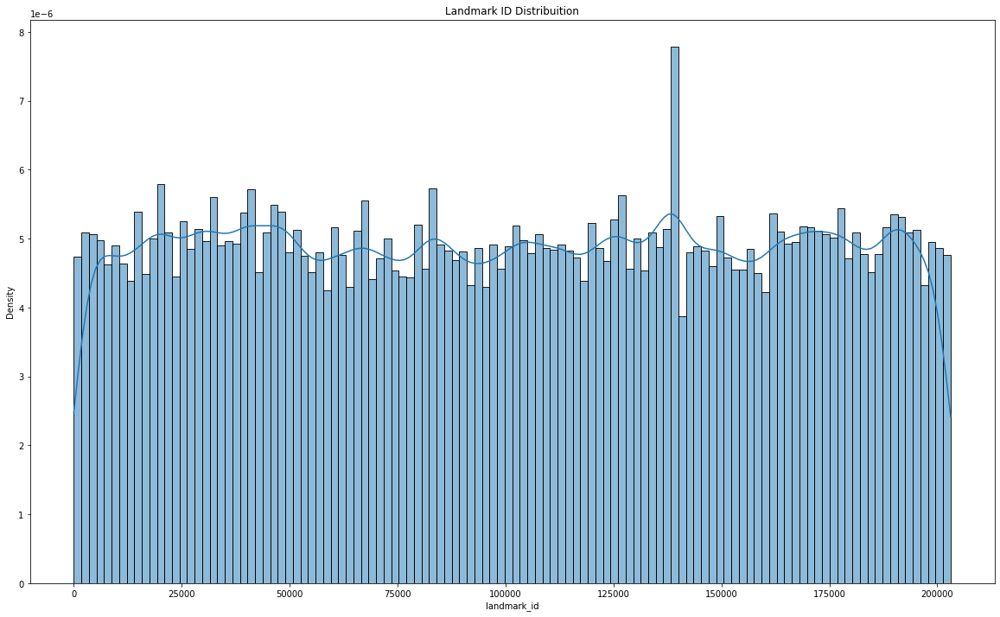

In [9]:
#Landmark ID distribution
plt.figure(figsize = (20, 12))
plt.title('Landmark ID Distribuition')
sns.histplot(df_train['landmark_id'], kde=True, stat="density")
plt.show()

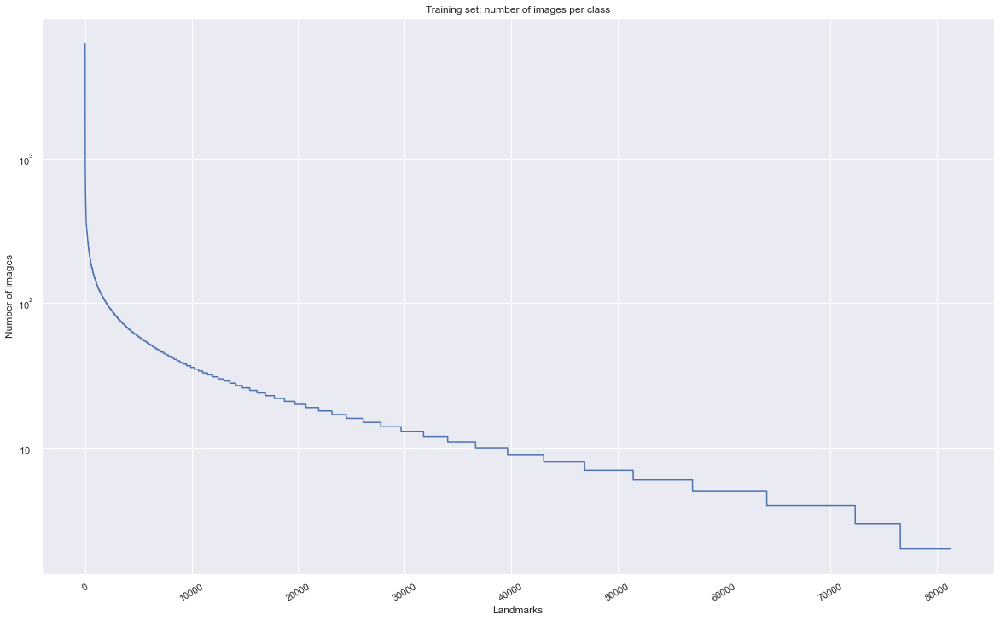

In [10]:
sns.set()
plt.figure(figsize = (20, 12))
plt.title('Training set: number of images per class')
sns.set_color_codes("pastel")
landmarks_fold = pd.DataFrame(df_landmark_counts["count"])
landmarks_fold.reset_index(inplace=True)
landmarks_fold.columns = ['landmark_id','count']
ax = landmarks_fold['count'].plot(logy=True, grid=True)
locs, labels = plt.xticks()
plt.setp(labels, rotation=30)
ax.set(xlabel="Landmarks", ylabel="Number of images")
plt.show()

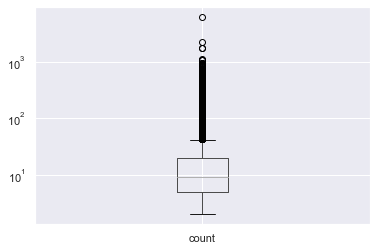

In [11]:
# Visualize outliers, min/max or quantiles of the landmarks count
sns.set()
ax = landmarks_fold.boxplot(column='count')
ax.set_yscale('log')

In [12]:
df_train.landmark_id.nunique()

81313

In [13]:
df_landmark_counts[:5]

,landmark_id,landmark_name,count
0,138982,ETH-Bibliothek,6272
1,126637,"Corktown, Toronto",2231
2,20409,Noraduz Cemetery,1758
3,83144,Museum of Folk Architecture and Ethnography in...,1741
4,113209,Salève,1135


In [14]:
landmark_counts.describe()

count    81313.000000
mean        19.436867
std         42.877489
min          2.000000
25%          5.000000
50%          9.000000
75%         20.000000
max       6272.000000
Name: landmark_id, dtype: float64

In [ ]:
landmark_counts[landmark_counts <= 10]

In [ ]:
landmark_counts[landmark_counts <= 100].shape[0] / df_train.landmark_id.nunique() * 100

In [16]:
landmark_counts[landmark_counts <= 100].shape[0] / df_train.landmark_id.nunique() * 100

97.57603335260045

In [17]:
landmark_counts.shape

(81313,)

In [18]:
def display_images(images_df, height, width, title=None):
    f, ax = plt.subplots(height, width, figsize=(30, int(np.round(30 * height / width))))
    if title:
        f.suptitle(title, fontsize = 30)
    for i, image in enumerate(images_df.itertuples()):
        ax[i // width, i % width].imshow(cv2.cvtColor(cv2.imread(image.file_path), cv2.COLOR_BGR2RGB)) 
        ax[i // width, i % width].axis('off')
        ax[i // width, i % width].set_title(f"ID: {image.id.split('.')[0]}\nLandmark Name: {image.landmark_name}", fontsize="12")
    plt.show() 

In [19]:
def display_images_by_count_position(position, height, width):
    display_images(df_train[df_train.landmark_name == df_landmark_counts.iloc[position].landmark_name].sample(width * height), height, width, title=f'{df_landmark_counts.iloc[position].landmark_name}: Position {position}')

In [20]:
def display_images_by_landmark(landmark_name, height, width):
    display_images(df_train[df_train.landmark_name == landmark_name].sample(width * height), height, width, title=f'{landmark_name}: Position {df_landmark_counts[df_landmark_counts.landmark_name == landmark_name].index[0]}')

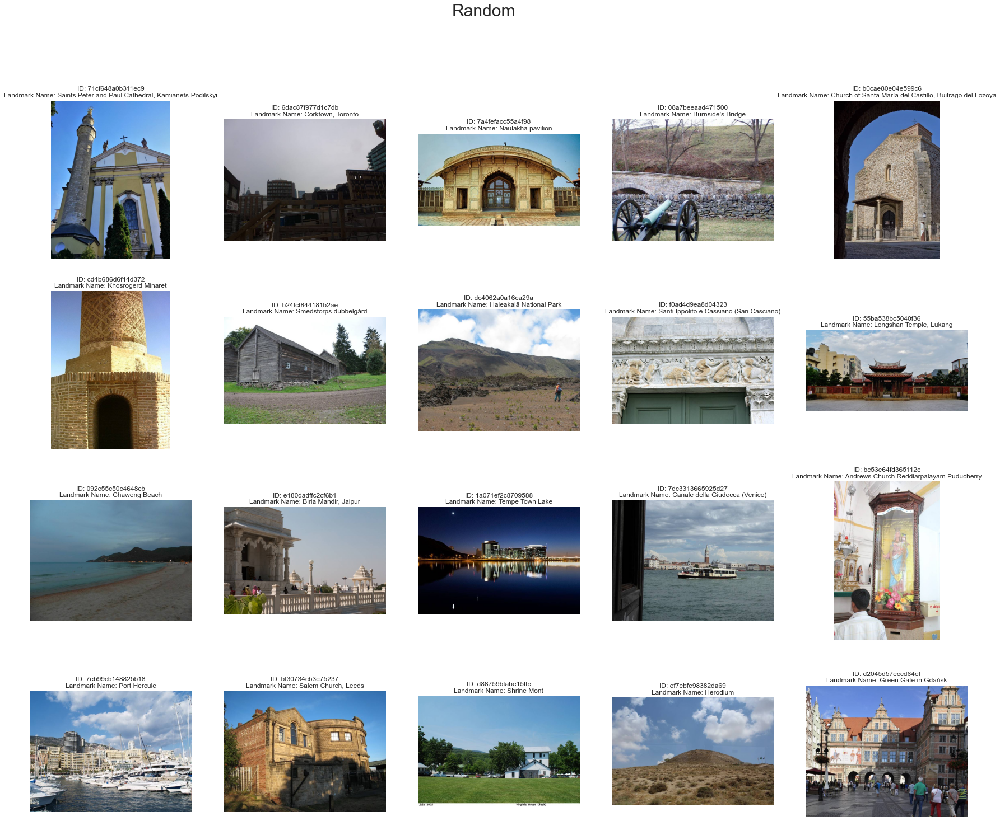

In [21]:
samples = df_train.sample(20)
display_images(samples, 4, 5, 'Random')

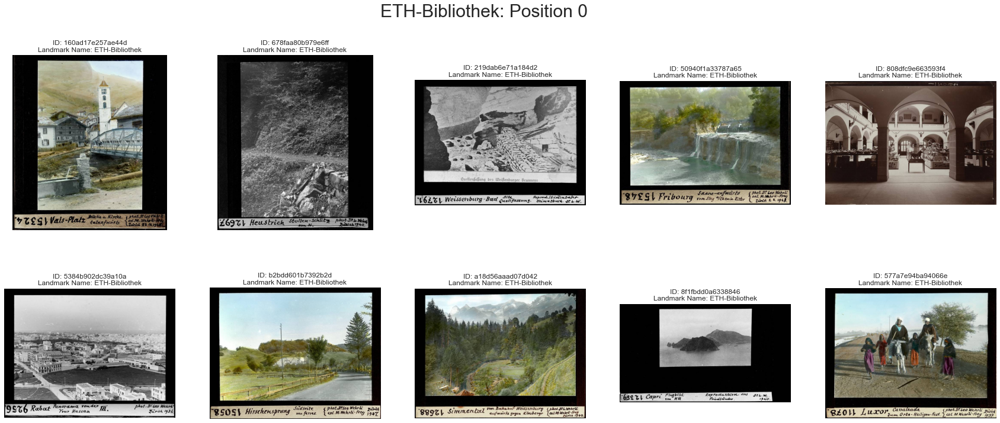

In [22]:
display_images_by_count_position(0, 2, 5)

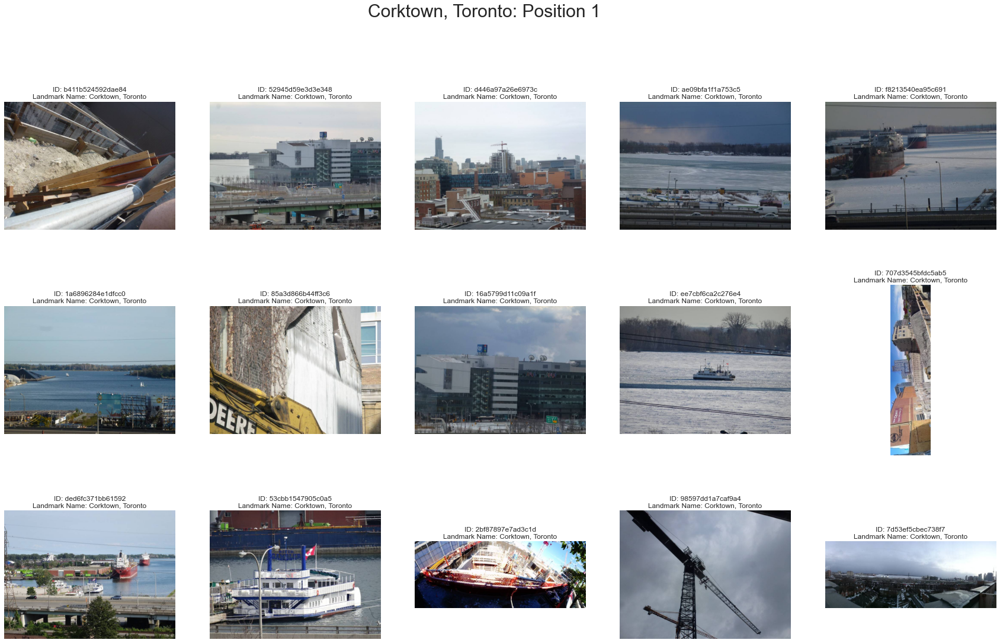

In [23]:
display_images_by_count_position(1, 3, 5)

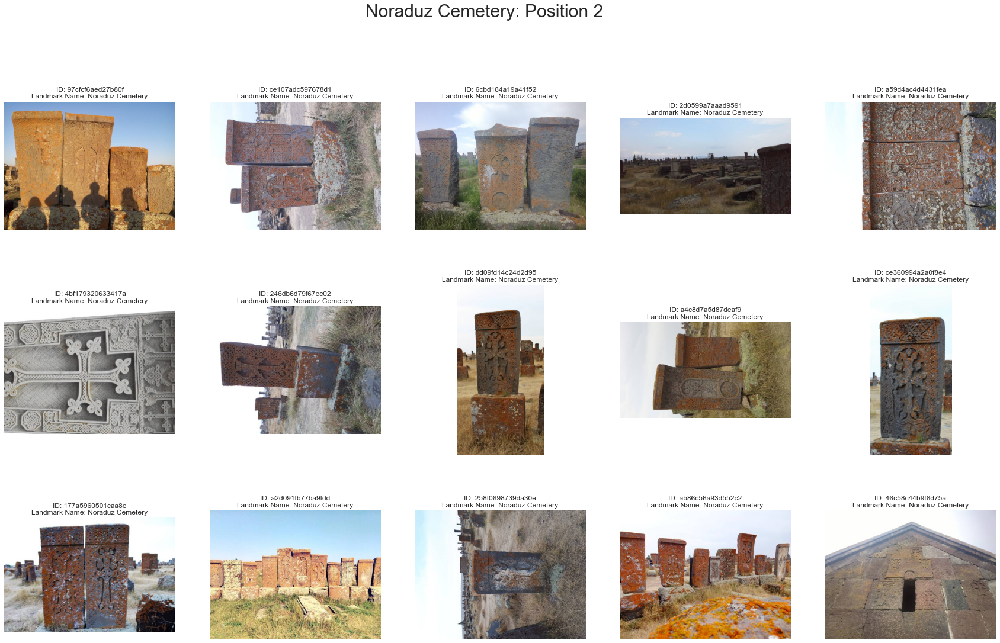

In [24]:
display_images_by_count_position(2, 3, 5)

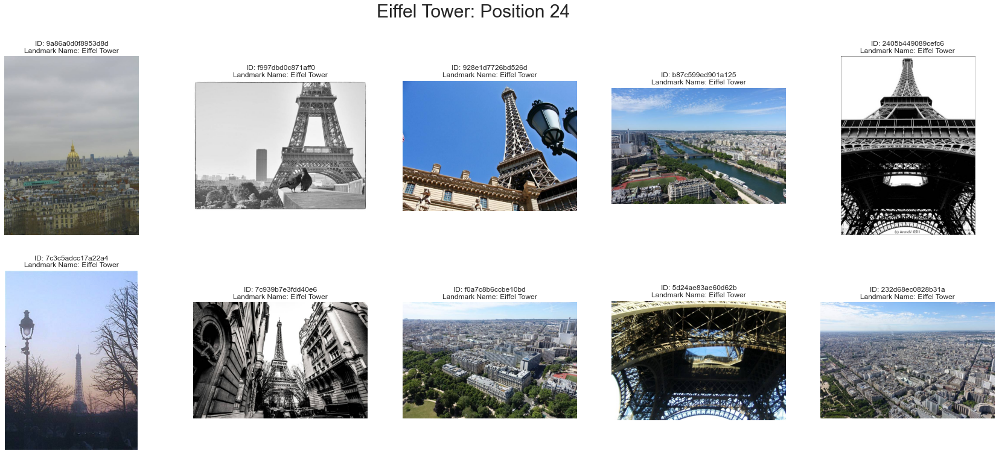

In [25]:
display_images_by_landmark("Eiffel Tower", 2, 5)

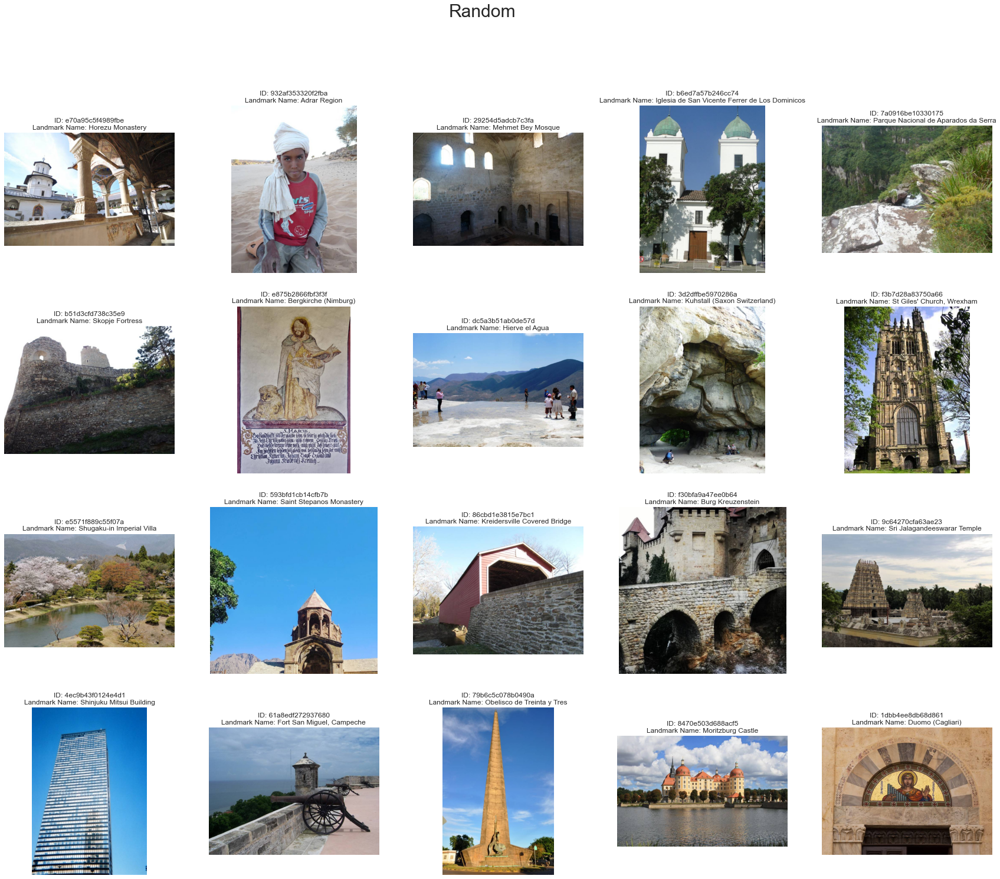

In [26]:
samples = df_train.sample(20)
display_images(samples, 4, 5, 'Random')

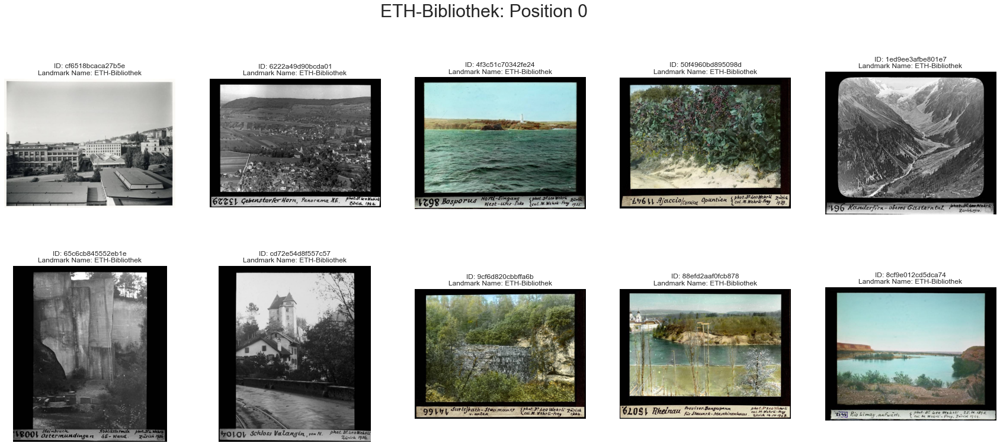

In [27]:
display_images_by_count_position(0, 2, 5)

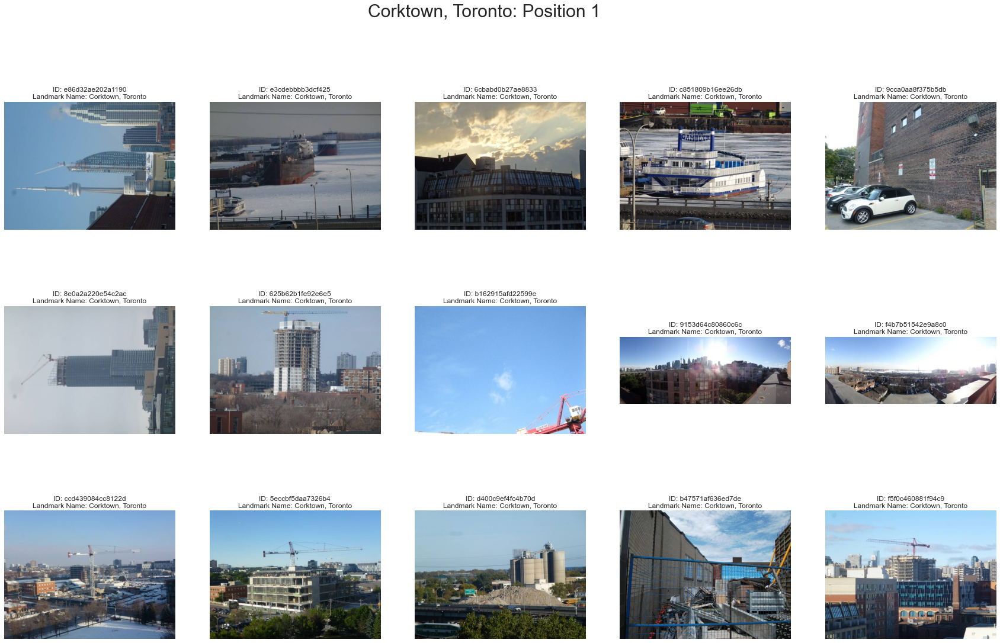

In [28]:
display_images_by_count_position(1, 3, 5)

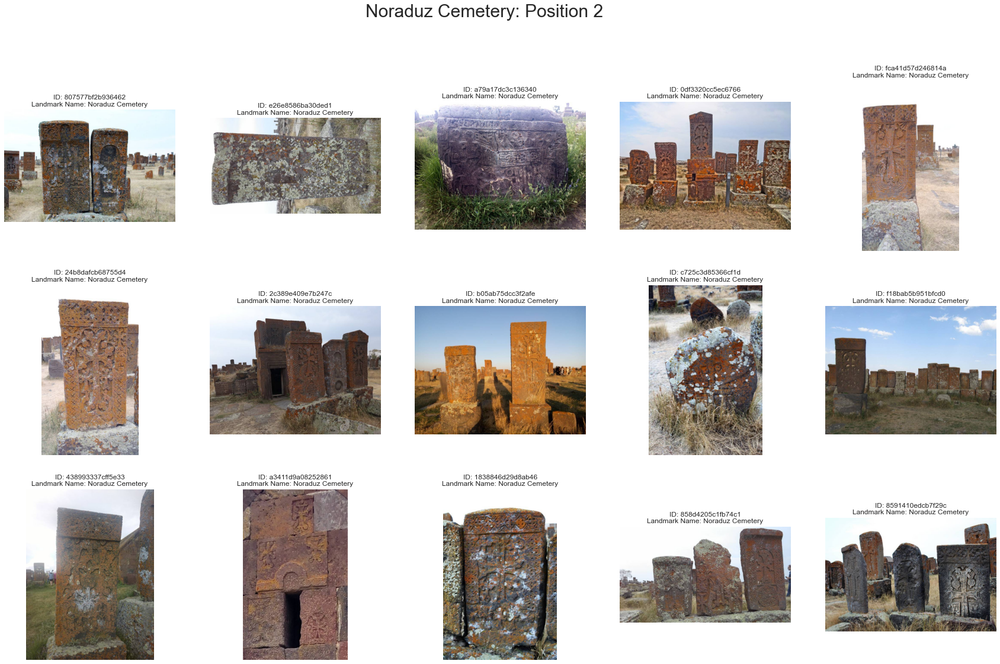

In [29]:
display_images_by_count_position(2, 3, 5)

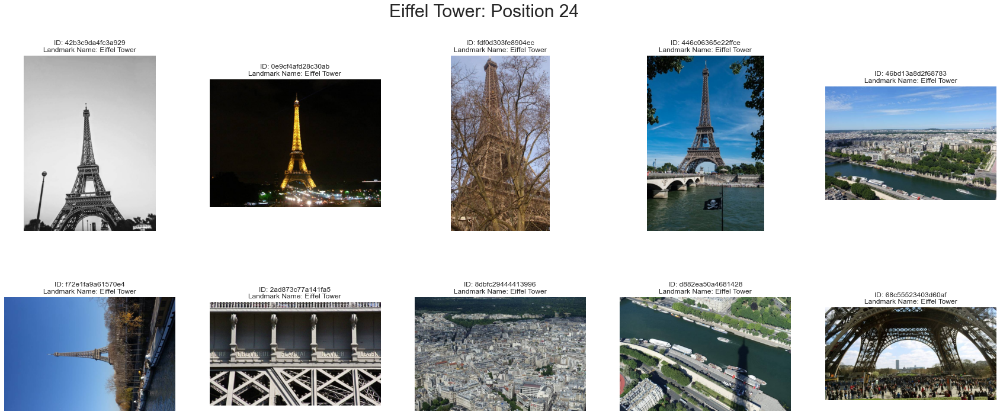

In [30]:
display_images_by_landmark("Eiffel Tower", 2, 5)